# SWOT Hydrology Science Application Tutorial on the Cloud

## Retrieving SWOT attributes (WSE, width, slope) and plotting a longitudinal profile along a river or over a basin

### Requirement
This tutorial can be run on a local environment. For the AWS cloud version of this notebook, click [here](https://podaac.github.io/tutorials/notebooks/DataStories/SWOTHR_Science_Application.html).

### Earthdata Login

**An Earthdata Login account is required to access data**, as well as discover restricted data, from the NASA Earthdata system. Thus, to access NASA data, you need Earthdata Login. Please visit [https://urs.earthdata.nasa.gov](https://urs.earthdata.nasa.gov) to register and manage your Earthdata Login account. This account is free to create and only takes a moment to set up.

**This code runs using [SWOT Level 2 Data Products (Version 2.0)](https://podaac.jpl.nasa.gov/SWOT?tab=mission-objectives&sections=about%2Bdata).**

_Notebook Authors: Arnaud Cerbelaud, Jeffrey Wade, & Cassie Nickles, NASA Jet Propulsion Laboratory - California Institute of Technology_

## Learning Objectives
1) Retrieve SWOT hydrological attributes on river reaches. Query reaches by:
    - River name
    - Downstream tracing from reach id (e.g. headwater to outlet) for river longitudinal profiles
    - Upstream tracing from reach id (e.g. outlet to full river network) for watershed analysis 
2) Plot a time series of WSE, width, slope data on the filtered data
3) Visualize an interactive map of WSE, width, slope data on the filtered data

## Import Packages

In [1]:
import xarray as xr
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import hvplot.xarray
import earthaccess
import zipfile

pd.set_option('display.max_columns', None) #make sure all columns displayed for shapefiles

C:\Users\nickles\Anaconda3\envs\env-swot-wrkshp\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Authenticate
Authenticate your Earthdata Login (EDL) information using the `earthaccess` python package as follows:

In [2]:
earthaccess.login() # Login with your EDL credentials if asked

## 1. Retrieve SWOT hydrological attributes on river reaches within the AWS cloud (Cal/Val data)
#### What data should we download?
- Optional step: Get the [.kmz file](https://podaac.github.io/tutorials/quarto_text/SWOT.html#swot-spatial-coverage) of SWOT passes/swaths for the and import it into Google Earth for visualization
- Determine which pass number corresponds to the river/basin you want to look at!
#### Search for multiple days of data

In [3]:
# Enter pass number(s)
pass_number    = ["354", "091"]   #Susquehanna River in NA
# e.g. 341, 576, 298 for Connecticut in NA, "236", "514", "542", "085", "363", "057", "335", "029" for Rhine in EU

# Enter continent code
continent_code = "NA"     # e.g. "AF", "NA", "EU", "SI", "AS", "AU", "SA", "AR", "GR"

# Retrieves granulev and links list from the passes we want, in this case by passing to `earthdata.search_data` function the data collection shortname and temporal bounds
links_list = []
for p in range(len(pass_number)):
    river_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_RIVERSP_2.0', 
                                        temporal = ('2024-01-25 00:00:00', '2024-05-16 23:59:59'),
                                        granule_name = "*Reach*_" + pass_number[p] + "_" + continent_code + "*")
    for r in range(len(river_results)):
        river_link = earthaccess.results.DataGranule.data_links(river_results[r], access='external')[0]
        links_list.append(river_link)

Granules found: 5
Granules found: 5


In [4]:
#links_list

### Download files to new data_downloads folder

In [5]:
earthaccess.download(links_list, "./data_downloads")

QUEUEING TASKS | : 100%|██████████| 10/10 [00:00<00:00, 998.98it/s]
PROCESSING TASKS | : 100%|██████████| 10/10 [00:06<00:00,  1.45it/s]
COLLECTING RESULTS | : 100%|██████████| 10/10 [00:00<00:00, 9804.36it/s]


['data_downloads\\SWOT_L2_HR_RiverSP_Reach_010_354_NA_20240206T150945_20240206T150952_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_011_354_NA_20240227T115450_20240227T115458_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_012_354_NA_20240319T083953_20240319T084000_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_013_354_NA_20240409T052714_20240409T052715_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_014_354_NA_20240430T020958_20240430T021000_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_010_091_NA_20240128T055759_20240128T055802_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_011_091_NA_20240218T024304_20240218T024307_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_012_091_NA_20240309T232808_20240309T232810_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_013_091_NA_20240330T201303_20240330T201314_PIC0_01.zip',
 'data_downloads\\SWOT_L2_HR_RiverSP_Reach_014_091_NA_20240420T165809_20240420T165820_PIC0_01.zip']

#### Unzip selected files
The native format for this data is a .zip file, and we want the .shp file within the .zip file, so we must first extract the data to open it. First, we’ll programmatically get the filename we just downloaded, and then extract all data to the data_downloads folder.

In [6]:
filenames = []
for l in range(len(links_list)):
    filenames.append(links_list[l].split("/")[-1])

In [7]:
for f in range(len(filenames)):
    with zipfile.ZipFile(f'data_downloads/{filenames[f]}', 'r') as zip_ref:
        zip_ref.extractall('data_downloads')

In [8]:
# replace zip file names with .shp ending
filename_shps = [filename.replace('zip', 'shp') for filename in filenames]

In [9]:
#initialize opened list of files
SWOT_HR_shps = []

# Loop through queried granules to open and stack all acquisition dates
for j in range(len(filename_shps)):
    SWOT_HR_shps.append(gpd.read_file(f'data_downloads/{filename_shps[j]}')) 

#### Aggregate unzipped files into dataframe

In [10]:
# Combine granules from all acquisition dates into one dataframe
SWOT_HR_df = gpd.GeoDataFrame(pd.concat(SWOT_HR_shps, ignore_index=True))

# Sort dataframe by reach_id and time
SWOT_HR_df = SWOT_HR_df.sort_values(['reach_id', 'time'])

SWOT_HR_df

,reach_id,time,time_tai,time_str,p_lat,p_lon,river_name,wse,wse_u,wse_r_u,wse_c,wse_c_u,slope,slope_u,slope_r_u,slope2,slope2_u,slope2_r_u,width,width_u,width_c,width_c_u,area_total,area_tot_u,area_detct,area_det_u,area_wse,d_x_area,d_x_area_u,layovr_val,node_dist,loc_offset,xtrk_dist,dschg_c,dschg_c_u,dschg_csf,dschg_c_q,dschg_gc,dschg_gc_u,dschg_gcsf,dschg_gc_q,dschg_m,dschg_m_u,dschg_msf,dschg_m_q,dschg_gm,dschg_gm_u,dschg_gmsf,dschg_gm_q,dschg_b,dschg_b_u,dschg_bsf,dschg_b_q,dschg_gb,dschg_gb_u,dschg_gbsf,dschg_gb_q,dschg_h,dschg_h_u,dschg_hsf,dschg_h_q,dschg_gh,dschg_gh_u,dschg_ghsf,dschg_gh_q,dschg_o,dschg_o_u,dschg_osf,dschg_o_q,dschg_go,dschg_go_u,dschg_gosf,dschg_go_q,dschg_s,dschg_s_u,dschg_ssf,dschg_s_q,dschg_gs,dschg_gs_u,dschg_gssf,dschg_gs_q,dschg_i,dschg_i_u,dschg_isf,dschg_i_q,dschg_gi,dschg_gi_u,dschg_gisf,dschg_gi_q,dschg_q_b,dschg_gq_b,reach_q,reach_q_b,dark_frac,ice_clim_f,ice_dyn_f,partial_f,n_good_nod,obs_frac_n,xovr_cal_q,geoid_hght,geoid_slop,solid_tide,load_tidef,load_tideg,pole_tide,dry_trop_c,wet_trop_c,iono_c,xovr_cal_c,n_reach_up,n_reach_dn,rch_id_up,rch_id_dn,p_wse,p_wse_var,p_width,p_wid_var,p_n_nodes,p_dist_out,p_length,p_maf,p_dam_id,p_n_ch_max,p_n_ch_mod,p_low_slp,geometry
623,71353200021,-1.000000e+12,-1.000000e+12,no_data,55.167022,-83.792685,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,15.682142,0.390864,-1.000000e+12,-1.000000e+12,34738.1,8.658179e+02,4879.7,865.8,34738.1,-1.000000e+12,-1.000000e+12,0.0000,49.762508,6067.85339,9582.71875,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,29360570,29360570,3,503349248,0.859529,2,-999,1,0,0.000000,2,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,1,1,"71353200031, no_data, no_data, no_data","71353300013, no_data, no_data, no_data",6.30,13.561736,105.0,2821.089,75,19531.502,15088.937191,-1.000000e+12,0,3,1,0,"LINESTRING (-83.72202 55.19853, -83.72249 55.1..."
1246,71353200021,-1.000000e+12,-1.000000e+12,no_data,55.167022,-83.792685,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,7.486161,0.326650,-1.000000e+12,-1.000000e+12,19855.9,8.663920e+02,3447.3,866.4,19855.9,-1.000000e+12,-1.000000e+12,0.0000,43.631674,5903.60669,9575.10742,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,-1.000000e+12,-1.000000e+12,-1.000000e+12,-999,29360570,29360570,3,503349248,0.826382,2,-999,1,0,0.000000,2,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,1,1,"71353200031, no_data, no_data, no_data","71353300013,

## Exploring the dataset

#### What acquisition dates and rivers do our downloaded files cover?

In [11]:
print('Available dates are:')
print(np.unique([i[:10] for i in SWOT_HR_df['time_str']]))
print('Available rivers are:')
print(np.unique([i for i in SWOT_HR_df['river_name']]))

Available dates are:
['2024-01-28' '2024-02-06' '2024-02-18' '2024-02-27' '2024-03-09'
 '2024-03-19' '2024-03-30' '2024-04-09' '2024-04-20' '2024-04-30'
 'no_data']
Available rivers are:
['Abitibi River' 'Abitibi River; Moose River' 'Albany River'
 'Allegheny River' 'Anacostia River; Lower Potomac River'
 'Appomattox River' 'Attawapiskat River' 'Black River'
 'Black River; Cape Fear River' 'Black River; Oswego River'
 'Blanche River' 'Brunswick River; Cape Fear River' 'Cape Fear River'
 'Cape Fear River; Haw River' 'Cape Fear River; Northeast Cape Fear River'
 'Cashie River' 'Castor River' 'Cattaraugus Creek' 'Chenango River'
 'Chickahominy River' 'Chickahominy River; James River'
 'Chickahominy River; Warwick River' 'Chuckatuck Creek'
 'Chuckatuck Creek; Elizabeth River'
 'Chuckatuck Creek; Jones Creek; Pagan River'
 'Chuckatuck Creek; Nansemond River' 'Clyde River' 'Conestoga River'
 'Conodoguinet Creek' 'Conodoguinet Creek; Susquehanna River'
 'Cooper River' 'Crowe River' 'Dan River

#### Filter dataframe by river name of interest and plot selected reaches:
_Note: Some rivers have multiple names, hence using the `contains` function_

In [12]:
# Enter river name
river = "Susquehanna River"  # e.g. "Rhine", "Connecticut River"

## Filter dataframe
SWOT_HR_df_river = SWOT_HR_df[(SWOT_HR_df.river_name.str.contains(river))]

# Plot geopandas dataframe with 'explore' by reach id
SWOT_HR_df_river[['reach_id','river_name','geometry']].explore('reach_id', style_kwds=dict(weight=6))



## 2. River longitudinal profile: trace reaches downstream of given starting reach using `rch_id_dn` field

_WARNING: This works as long as the data is exhaustive (no missing SWORD reaches)_



#### First, let's set up a dictionary relating all reaches in the dataset to their downstream neighbor

_Note: rch_dn_dict[rch_id] gives a list of all the reaches directly downstream from rch_id_

In [13]:
# Format rch_id_dn for dictionary. Rch_id_dn allows for multiple downstream reaches to be stored
# Also removes spaces in attribute field
rch_id_dn = [[x.strip() for x in SWOT_HR_df.rch_id_dn[j].split(',')] for j in range(0,len(SWOT_HR_df.rch_id_dn))]

# Filter upstream reach ids to remove 'no_data'
rch_id_dn_filter = [[x for x in dn_id if x.isnumeric()] for dn_id in rch_id_dn]

# Create lookup dictionary for river network topology: Downstream
rch_dn_dict = {SWOT_HR_df.reach_id[i]: rch_id_dn_filter[i] for i in range(len(SWOT_HR_df))}

#### Then, starting from a given reach, let's trace all connected downstream reaches

Find the Reach IDs on [www.swordexplorer.com](https://www.swordexplorer.com/)

In [14]:
# Enter reach_id from which we will trace downstream    (e.g. headwaters of the Connecticut River)
rch_dn_st = {"Connecticut River": '73120000691',
             "Rhine": '23267000651',
             "Susquehanna River": '73160300071'
            }

# Initialize list to store downstream reaches, including starting reach
rch_dn_list = [rch_dn_st[river]]
# Retrieve first downstream id of starting reach and add to list
rch_dn_next = rch_dn_dict[rch_dn_st[river]][0]

# Trace next downstream reach until we hit the outlet (or here the last reach on file)
while len(rch_dn_next) != 0:
    # Add reach to list if value exists
    if len(rch_dn_next) != 0:
        rch_dn_list.append(rch_dn_next)
    # Recursively retrieve first downstream id of next reach
    # Catch error if reach isn't in downloaded data
    try:
        rch_dn_next = rch_dn_dict[rch_dn_next][0]
    except:
        break

#### Finally, we filtered our downloaded data by the traced reaches to create a plot

In [15]:
# Filter downloaded data by downstream traced reaches
SWOT_dn_trace = SWOT_HR_df[SWOT_HR_df.reach_id.isin(rch_dn_list)]

# Remove reaches from rch_dn_list that are not present in SWOT data
rch_dn_list = [rch for rch in rch_dn_list if rch in SWOT_HR_df.reach_id.values]

SWOT_dn_trace[['reach_id','river_name','geometry']].explore('river_name', style_kwds=dict(weight=6))

#### Note: If not all of your data appears, there might be a SWORD database error 
Let's check by singling out the reach it left off on. 

For example, in the Connecticut River, it looks like reach '73120000531' at the time of this run (4/1/24) has 'no_data' in the `rch_id_up` and `rch_id_dn` fields when there should be values. To help out the SWORD database creators, we can report this discrepancy by clicking the `Report Reach` button at [https://www.swordexplorer.com/](https://www.swordexplorer.com/). SWORD should be updated quarterly.

In [ ]:
SWOT_HR_df[SWOT_HR_df.reach_id == '73120000531']



## 3. Watershed analysis: trace reaches upstream of starting reach using `rch_id_up` field

_WARNING: This works as long as the data is exhaustive (no missing SWORD reaches)_



#### First, let's set up a dictionary relating all reaches in the dataset to their upstream neighbor

_Note: rch_up_dict[rch_id] gives a list of all the reaches directly upstream from rch_id_

In [17]:
# Format rch_id_up for dictionary. Rch_id_up allows for multiple upstream reaches to be stored
# Also removes spaces in attribute field
rch_id_up = [[x.strip() for x in SWOT_HR_df.rch_id_up[j].split(',')] for j in range(0,len(SWOT_HR_df.rch_id_up))]

# Filter upstream reach ids to remove 'no_data'
rch_id_up_fil = [[x for x in ups_id if x.isnumeric()] for ups_id in rch_id_up]

# Create lookup dictionary for river network topology: Upstream
rch_up_dict = {SWOT_HR_df.reach_id[i]: rch_id_up_fil[i] for i in range(len(SWOT_HR_df))}

#### Then, starting from a given reach, let's trace all connected upstream reaches
This adds a bit of complexity, as we  need to keep track of multiple branches upstream of the starting reach.
Find outlet Reach IDs on [www.swordexplorer.com](https://www.swordexplorer.com/)

In [18]:
# Enter reach_id from which we will trace upstream    (e.g. outlet of the River)
rch_up_st = {"Connecticut River": '73120000021',
             "Rhine": '23265000051',
             "Susquehanna River": '73160100011'
            }

# Initialize list to store traced upstream reaches, including starting reach
rch_up_list = [rch_up_st[river]]
# Retrieve ids of reaches upstream of starting reach and add to list
rch_up_next = rch_up_dict[rch_up_st[river]]
# For upstream tracing, we need to set a list of next upstream ids to start while loop
rch_next_id = rch_up_next

# Loop until no more reaches to trace
while len(rch_next_id) != 0:
    # Initialize list to store next upstream ids
    rch_next_id = []
    # Loop through next upstream ids for given reach
    for rch_up_sel in rch_up_next:
        # Get values of existing upstream ids of rch_up_next reaches
        # If reach isn't in SWOT data (usually ghost reaches), continue to next reach
        try:
            rch_next_id = rch_next_id + rch_up_dict[rch_up_sel]
        except:
            continue
        # Append id to list
        rch_up_list.append(rch_up_sel)
    # If reaches exist, add to list for next cycle of tracing
    if len(rch_next_id) != 0:
        rch_up_next = rch_next_id

#### Finally, we filtered our downloaded data by the traced reaches to create a plot

In [19]:
# Filter downloaded data by upstream traced reaches
SWOT_up_trace = SWOT_HR_df[SWOT_HR_df.reach_id.isin(rch_up_list)]

# Remove reaches from rch_up_list that are not present in SWOT data
rch_up_list = [rch for rch in rch_up_list if rch in SWOT_HR_df.reach_id.values]

SWOT_up_trace[['reach_id','river_name','geometry']].explore('river_name', style_kwds=dict(weight=6))

#### Note: If not all of your data appears, there might be a SWORD database error 
Let's check by singling out the reach it left off on. 

For example, in the Connecticut River, it looks like reach '73120000131' at the time of this run (4/1/24) has 'no_data' in the `rch_id_up` field when there should be values. To help out the SWORD database creators, we can report this discrepancy by clicking the `Report Reach` button at [https://www.swordexplorer.com/](https://www.swordexplorer.com/). SWORD should be updated quarterly.

In [ ]:
SWOT_HR_df[SWOT_HR_df.reach_id == '73120000131']

## 4. Visualize and plot a time series of WSE/width/slope longitudinal profiles

#### Let's create a time series dataframe from the downstream filtered database

In [21]:
# Retrieve all possible acquisition dates (keeping only YYYY-MM-DD)
dates = np.unique([i[:10] for i in [x for x in SWOT_HR_df['time_str'] if x!='no_data']])

# Create a new database for time series analysis with unique reach_ids
SWOT_dn_trace_time = SWOT_dn_trace.set_index('reach_id').groupby(level=0) \
                                  .apply(lambda df: df.reset_index(drop=True)) \
                                  .unstack().sort_index(axis=1, level=1)

SWOT_dn_trace_time.columns = ['{}_{}'.format(x[0],dates[x[1]]) for x in SWOT_dn_trace_time.columns]

#### Plot a longitudinal profile for selected SWOT variable

In [22]:
# Explore variables you could choose to plot
for var in ["wse","slope","width","len"]:
    print(SWOT_dn_trace.columns[SWOT_dn_trace.columns.str.contains(var)])

Index(['wse', 'wse_u', 'wse_r_u', 'wse_c', 'wse_c_u', 'area_wse', 'p_wse',
       'p_wse_var'],
      dtype='object')
Index(['slope', 'slope_u', 'slope_r_u', 'slope2', 'slope2_u', 'slope2_r_u'], dtype='object')
Index(['width', 'width_u', 'width_c', 'width_c_u', 'p_width'], dtype='object')
Index(['p_length'], dtype='object')


In [23]:
# Enter variable of interest for plotting
varstr = "wse"

The error that outputs the following cell is because of the SWORD database discrepancy noted above. When this is corrected, only the graph should appear without the error.

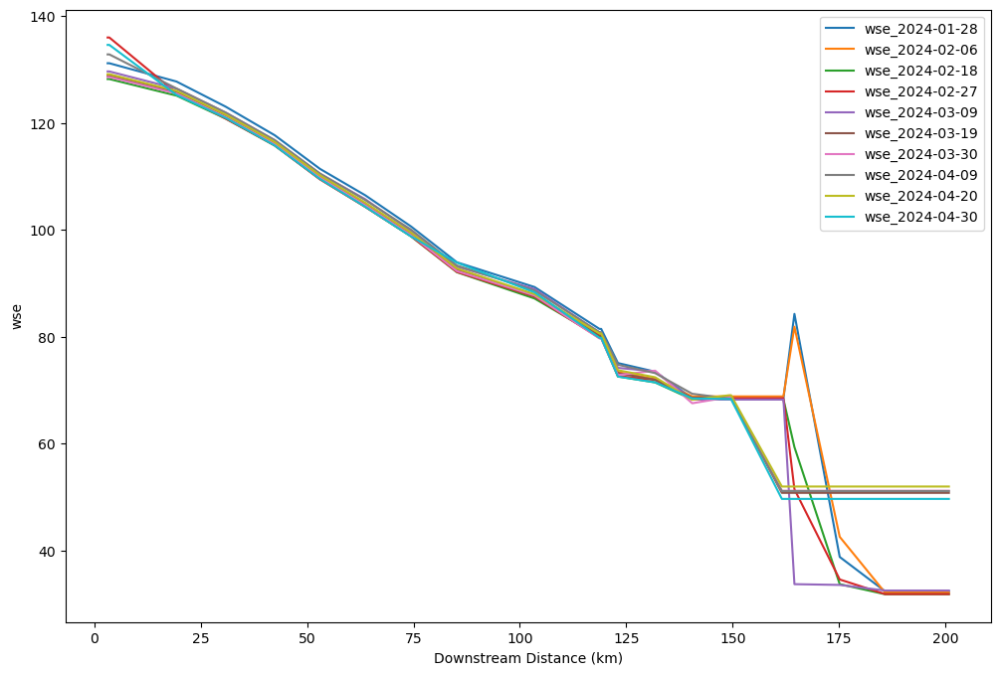

In [24]:
# Find cumulative length on the longitudinal profile
length_list    = np.nan_to_num([SWOT_dn_trace.p_length[SWOT_dn_trace.reach_id == rch].mean()/1000 for rch in rch_dn_list])
cumlength_list = np.cumsum(length_list)

## Plot a longitudinal profile from the downstream tracing database

## Plot a longitudinal profile from the downstream tracing database
plt.figure(figsize=(12,8))
for t in dates:
    
    # Store the quantity of interest (wse, width etc.) at time t
    value = SWOT_dn_trace_time.loc[rch_dn_list,varstr+'_'+t]
    
    # Remove set negative values (bad observations) to NaN and forward fill NaNs
    value[value < 0] = np.nan
    value = value.ffill()
    
    # Plot the data
    plt.plot(cumlength_list, value, label = varstr+'_'+t)
    
plt.xlabel('Downstream Distance (km)')
plt.ylabel(varstr)
plt.legend()

#### Map the longitudinal profile of selected SWOT variable

In [25]:
# Choose a date
date = dates[1]

In [26]:
#Set one column as the active geometry in the new database
SWOT_dn_trace_time = SWOT_dn_trace_time.set_geometry("geometry_"+date)

#Set cleaner colorbar bounds for better visualization
vmin = np.percentile([i for i in SWOT_dn_trace_time[varstr+'_'+date] if i>0],5)
vmax = np.percentile([i for i in SWOT_dn_trace_time[varstr+'_'+date] if i>0],95)

# Interactive map
SWOT_dn_trace_time.explore(varstr+'_'+date,
                           vmin = vmin,
                           vmax = vmax,
                           cmap = "Blues", #"Blues",
                           control_scale = True,
                           tooltip = varstr+'_'+date,  # show "varstr+'_'+dates[0]" value in tooltip (on hover)
                           popup = True,  # show all values in popup (on click)
                           #tiles = "CartoDB positron",  # use "CartoDB positron" tiles
                           style_kwds=dict(weight=10)
                          )


## Supplemental



### We can also map the upstream traced database

In [27]:
SWOT_up_trace_time = SWOT_up_trace.set_index('reach_id').groupby(level=0) \
                                  .apply(lambda df: df.reset_index(drop=True)) \
                                  .unstack().sort_index(axis=1, level=1)

SWOT_up_trace_time.columns = ['{}_{}'.format(x[0],dates[x[1]]) for x in SWOT_up_trace_time.columns]

SWOT_up_trace_time = SWOT_up_trace_time.set_geometry("geometry_"+date)

#Set cleaner colorbar bounds for better visualization
vmin = np.percentile([i for i in SWOT_up_trace_time[varstr+'_'+date] if i>0],5)
vmax = np.percentile([i for i in SWOT_up_trace_time[varstr+'_'+date] if i>0],95)

# Interactive map
SWOT_up_trace_time.explore(varstr+'_'+date,
                           vmin = vmin,
                           vmax = vmax,
                           cmap = "Blues", #"Blues",
                           control_scale = True,
                           tooltip = varstr+'_'+date,  # show "varstr+'_'+dates[0]" value in tooltip (on hover)
                           popup = True,  # show all values in popup (on click)
                           tiles = "CartoDB positron",  # use "CartoDB positron" tiles
                           style_kwds=dict(weight=5)
                          )